In [106]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import scipy.stats as stats

pd.set_option('display.max_rows', None)

In [107]:
df_wpm15= pd.read_csv('pct15.csv')
df_wpm60= pd.read_csv('pct60.csv')

In [108]:
def functext(f):
    import inspect
    print(inspect.getsource(f))

In [109]:
df_wpm15.describe().astype('int')

,rank,wpm,raw,acc,consistency,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct
count,401328,401328,401328,401328,401328,401328,401328,401328,401328,401328,401328,401328,401328,401328
mean,200664,98,100,97,80,1,49,49,41,49,24,49,8,49
std,115853,32,33,3,8,3,28,28,36,28,8,28,39,28
min,1,0,0,50,0,0,0,0,0,0,0,0,-98,0
25%,100332,74,76,96,76,0,24,24,0,24,24,24,-19,24
50%,200664,97,99,98,82,0,49,49,49,49,29,49,5,49
75%,300996,119,122,100,86,2,74,74,74,74,29,74,33,74
max,401328,304,315,100,100,88,99,99,99,99,29,99,99,99


In [110]:
df_wpm60.describe().astype('int')

,rank,wpm,raw,acc,consistency,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct
count,394268,394268,394268,394268,394267,394268,394268,394268,394268,394268,394268,394268,394268,394268
mean,197171,78,80,95,72,2,49,49,49,49,40,49,0,49
std,113845,27,29,3,8,4,28,28,28,28,18,28,33,28
min,1,0,0,55,0,0,0,0,0,0,0,0,-97,0
25%,98574,58,59,94,68,0,24,24,24,24,24,24,-21,24
50%,197156,75,77,96,73,0,49,49,49,49,49,49,-1,49
75%,295776,95,99,97,77,3,74,74,74,74,56,74,19,74
max,394345,277,300,100,96,68,99,99,99,99,56,99,99,99


In [111]:
df_wpm15.query("wpm > 100 and acc < 75").sort_values('wpm',ascending=False)

,rank,name,wpm,raw,acc,consistency,datetime,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct
128537,128538,boquintana,112.80,112.80,73.49,71.67,2021-11-27 09:57:26.406,0.00,31.80092,33.798790,99.96860,87.04451,29.260110,89.34014,-68.16768,98.07813
178613,178614,NotJee,102.26,154.19,67.84,45.26,2021-12-16 07:10:21.240,51.93,44.48307,5.964199,99.98605,99.44484,0.005731,88.44636,-55.50298,95.09503


In [112]:
df_wpm60.query("wpm > 100 and acc < 80").sort_values('wpm',ascending=False).head(10)

,rank,name,wpm,raw,acc,consistency,datetime,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct
58363,58366,boquintana,107.58,107.58,71.72,65.75,2021-12-12 23:29:05.228,0.0,14.76635,17.415820,99.98935,82.59661,56.838750,86.26848,-85.22300,99.89474
65716,65719,Artesod,105.00,146.80,79.84,80.58,2023-02-13 19:34:02.316,41.8,16.61332,2.205099,99.77224,12.49962,0.004565,63.98161,-83.15892,99.83083


In [113]:
df_wpm15[df_wpm15['diff'] > 70]

,rank,name,wpm,raw,acc,consistency,datetime,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct
39878,39879,Zayn,141.55,220.72,78.34,86.18,2025-01-29 22:49:51.779,79.17,9.919567,0.081978,99.78696,27.51365,0.000249,11.17116,-89.867390,99.95689
108102,108103,minadiaa,118.32,189.47,85.23,66.42,2023-01-16 21:18:42.107,71.15,26.819960,0.712883,98.92058,93.74975,0.000498,69.99188,-72.100630,98.75812
378004,378005,david898679,48.80,136.80,58.48,85.75,2021-11-08 02:35:06.820,88.00,94.088130,13.604080,99.99576,29.74151,0.000000,90.27279,-5.907637,64.19786


In [114]:
df_wpm60[df_wpm60['diff'] > 60]

,rank,name,wpm,raw,acc,consistency,datetime,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct
95646,95653,babayagaindo,96.78,160.37,79.55,84.73,2022-05-03 00:40:21.633,63.59,24.20891,0.933375,99.79380,2.866071,0.000254,79.66865,-75.584880,99.39838
363860,363938,Derrickseals,41.59,109.78,56.96,59.71,2021-09-08 15:58:56.504,68.19,92.22280,15.818170,99.99924,93.635550,0.000000,90.78774,-7.776436,59.02483


In [115]:
df_wpm15[df_wpm15['name'].isin(['Artesod','boquintana'])]

,rank,name,wpm,raw,acc,consistency,datetime,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct
29784,29785,Artesod,147.2,160.8,96.02,86.16,2022-10-09 04:43:22.000,13.6,7.349101,4.06027,81.66562,27.57495,2.252771,75.70242,-74.31652,99.07258
128537,128538,boquintana,112.8,112.8,73.49,71.67,2021-11-27 09:57:26.406,0.0,31.800920,33.79879,99.96860,87.04451,29.260110,89.34014,-68.16768,98.07813


In [116]:
df_wpm60[df_wpm60['name'].isin(['boquintana','NotJee','Zayn','minadiaa','david898679'])]

,rank,name,wpm,raw,acc,consistency,datetime,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct
58363,58366,boquintana,107.58,107.58,71.72,65.75,2021-12-12 23:29:05.228,0.00,14.76635,17.415820,99.98935,82.59661,56.838750,86.26848,-85.223000,99.89474
123792,123802,david898679,89.99,106.38,91.35,75.08,2021-11-10 03:20:12.049,16.39,31.30713,18.367960,90.24039,39.35115,1.498473,87.98736,-58.933260,96.67942
145469,145484,Zayn,85.20,88.00,97.31,78.96,2024-11-01 04:59:46.490,2.80,36.86401,36.682410,31.76088,18.99850,28.891260,18.30836,5.103128,40.16735
159290,159309,minadiaa,82.59,129.18,76.79,38.86,2023-01-17 20:51:05.583,46.59,40.29214,6.049185,99.93101,99.62589,0.001775,65.75502,-59.638880,96.85772
289043,289121,NotJee,59.39,68.59,89.97,77.70,2021-12-08 06:32:42.750,9.20,73.20630,62.711910,93.98480,24.97793,6.951363,86.51222,-20.778510,74.18862


In [117]:
df_wpm15.sort_values('deltapct',ascending=False).head(5)

,rank,name,wpm,raw,acc,consistency,datetime,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct
1151,1152,arman2435,199.17,234.37,84.75,4.70,2021-02-04 01:35:36.581,35.20,0.284306,0.033140,99.02623,99.96910,0.044602,98.395580,-98.74193,99.99975
8482,8483,rafrafthefirst,169.47,187.86,77.45,85.48,2024-12-03 05:10:10.120,18.39,2.111988,0.795609,99.84128,31.47725,0.979747,17.907300,-97.72929,99.99950
6781,6782,Kaguya,172.76,172.76,84.67,7.07,2020-12-22 14:55:01.762,0.00,1.684159,2.035492,99.04542,99.96088,29.260110,99.166770,-97.36126,99.99925
274,275,cole22,218.37,231.17,89.44,83.26,2024-04-23 18:16:45.373,12.80,0.067526,0.038373,97.08742,44.31936,2.838327,39.438810,-97.01989,99.99900
4456,4457,Arckrun,179.19,179.19,87.91,77.91,2025-03-19 14:37:46.117,0.00,1.103586,1.359237,98.01135,69.78531,29.260110,3.616742,-96.90777,99.99875


In [118]:
df_wpm60.sort_values('deltapct',ascending=False).head(5)

,rank,name,wpm,raw,acc,consistency,datetime,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct
1596,1597,Khush_12,166.00,214.19,86.59,80.31,2024-07-08 18:49:39.186,48.19,0.402011,0.031451,98.03738,13.477380,0.001268,29.102540,-97.63536,99.99975
6397,6398,fastestonehere,146.40,196.20,84.65,82.32,2025-02-12 17:41:07.044,49.80,1.616920,0.087504,98.94513,7.312792,0.000761,7.403593,-97.32821,99.99949
9290,9291,Arckrun,140.60,150.60,84.96,67.18,2025-03-28 14:22:58.036,10.00,2.346627,1.751854,98.84393,78.181080,5.823196,1.513184,-96.49731,99.99924
4689,4690,DunDun,150.99,150.99,87.69,78.34,2024-04-23 19:27:49.436,0.00,1.185742,1.719389,97.20596,21.810550,56.838750,35.003600,-96.02022,99.99899
13414,13415,Red525,134.40,177.40,84.53,82.44,2021-10-13 15:26:49.485,43.00,3.387036,0.290158,98.98090,7.026439,0.003805,89.217490,-95.59386,99.99873


In [119]:
df_wpm15.sort_values('diffpct').head(5)

,rank,name,wpm,raw,acc,consistency,datetime,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct
378004,378005,david898679,48.80,136.80,58.48,85.75,2021-11-08 02:35:06.820,88.00,94.088130,13.604080,99.99576,29.74151,0.000000,90.27279,-5.907637,64.19786
39878,39879,Zayn,141.55,220.72,78.34,86.18,2025-01-29 22:49:51.779,79.17,9.919567,0.081978,99.78696,27.51365,0.000249,11.17116,-89.867390,99.95689
108102,108103,minadiaa,118.32,189.47,85.23,66.42,2023-01-16 21:18:42.107,71.15,26.819960,0.712883,98.92058,93.74975,0.000498,69.99188,-72.100630,98.75812
222227,222228,lminlu,92.76,157.54,66.33,69.54,2020-11-11 16:52:36.513,64.78,55.316350,4.966013,99.98904,90.44447,0.000748,99.71794,-44.672690,90.31939
386294,386295,kareemahlees,43.93,108.63,63.77,72.16,2020-12-14 20:38:53.520,64.70,96.251940,38.989550,99.99252,86.12531,0.000997,99.28463,-3.740581,62.15440


In [120]:
df_wpm60.sort_values('diffpct').head(5)

,rank,name,wpm,raw,acc,consistency,datetime,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct
363860,363938,Derrickseals,41.59,109.78,56.96,59.71,2021-09-08 15:58:56.504,68.19,92.22280,15.818170,99.99924,93.635550,0.000000,90.787740,-7.776436,59.02483
95646,95653,babayagaindo,96.78,160.37,79.55,84.73,2022-05-03 00:40:21.633,63.59,24.20891,0.933375,99.79380,2.866071,0.000254,79.668650,-75.584880,99.39838
144766,144781,Liv.M,85.40,142.60,76.54,84.33,2022-08-22 23:19:38.908,57.20,36.62154,2.817627,99.93887,3.388558,0.000507,74.874450,-63.317340,97.69649
6397,6398,fastestonehere,146.40,196.20,84.65,82.32,2025-02-12 17:41:07.044,49.80,1.61692,0.087504,98.94513,7.312792,0.000761,7.403593,-97.328210,99.99949
158294,158312,audreyt,82.79,131.18,77.19,77.07,2022-05-27 17:44:47.199,48.39,40.03470,5.412308,99.91782,28.208730,0.001015,78.528060,-59.883130,96.92037


In [121]:
df_wpm60.sort_values('consistencypct',ascending=False).head(5)

,rank,name,wpm,raw,acc,consistency,datetime,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct
186,187,kogasa,196.25,205.39,95.81,NaN,2020-07-16 00:35:06.729,9.14,0.047176,0.051234,55.21016,99.99975,7.246847,99.99975,-55.162990,95.62556
394267,394345,EarlyRiser1,0.60,0.60,100.00,0.0,2022-04-21 13:01:50.618,0.00,99.999750,99.999750,0.00000,99.99214,56.838750,80.18860,99.999750,0.00000
394213,394291,ELGG_11,7.00,7.20,77.08,0.0,2024-11-02 09:43:31.000,0.20,99.985540,99.987060,99.92036,99.99214,56.548840,18.18940,0.065184,47.28154
392761,392839,AliHabibiIssa,20.00,24.60,85.16,0.0,2022-10-10 17:56:35.948,4.60,99.606360,99.292870,98.77063,99.99214,19.342170,71.92747,0.835726,46.03569
158692,158711,lackof03,82.60,85.80,95.68,0.0,2024-11-10 02:38:37.176,3.20,40.192200,39.344810,57.00868,99.99214,26.146170,17.36864,-16.816480,70.02318


In [122]:
df_wpm15.sort_values('consistencypct',ascending=False).head(5)

,rank,name,wpm,raw,acc,consistency,datetime,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct
401327,401328,mohamad33,0.80,0.80,100.00,0.0,2022-10-26 13:18:50.747,0.00,99.99975,99.99975,0.00000,99.99103,29.26011,74.67184,99.999750,0.000000
401298,401299,steelhand18,6.39,6.39,88.89,0.0,2023-04-05 17:11:26.644,0.00,99.99228,99.99576,97.42081,99.99103,29.26011,65.03558,2.571463,54.057030
401287,401288,aniket333,6.40,6.40,90.00,0.0,2024-09-12 07:06:34.742,0.00,99.98929,99.99327,96.62147,99.99103,29.26011,27.80743,3.367819,52.980600
215365,215366,AbeI,94.34,98.33,96.06,0.0,2023-03-16 18:16:59.972,3.99,53.54224,50.98922,81.40374,99.99103,21.23301,66.26874,-27.861500,80.743180
401275,401273,myna_cwuthair,7.20,7.20,100.00,0.0,2025-01-21 00:57:13.431,0.00,99.98605,99.98953,0.00000,99.99103,29.26011,12.35473,99.986050,0.002741


In [123]:
df_wpm15[np.isnan(df_wpm15['consistency'])]

,rank,name,wpm,raw,acc,consistency,datetime,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct


In [124]:
df_wpm60[np.isnan(df_wpm60.consistency)]

,rank,name,wpm,raw,acc,consistency,datetime,diff,wpmpct,rawpct,accpct,consistencypct,diffpct,datetimepct,delta,deltapct
186,187,kogasa,196.25,205.39,95.81,NaN,2020-07-16 00:35:06.729,9.14,0.047176,0.051234,55.21016,99.99975,7.246847,99.99975,-55.16299,95.62556


In [125]:
df_wpm60.datetime.sort_values()

186       2020-07-16 00:35:06.729
19066     2020-10-12 00:35:37.572
370593    2020-10-12 02:30:34.360
87369     2020-10-12 03:46:38.265
246275    2020-10-12 04:18:23.166
112675    2020-10-12 04:53:47.473
133486    2020-10-12 05:14:42.008
35546     2020-10-12 07:09:47.278
169430    2020-10-12 07:53:20.934
89008     2020-10-12 12:07:50.577
368151    2020-10-12 12:59:04.351
163719    2020-10-12 13:23:23.611
293980    2020-10-12 14:25:33.373
57180     2020-10-12 15:04:22.430
59631     2020-10-12 16:01:12.393
274982    2020-10-12 18:22:09.211
179988    2020-10-12 18:42:35.736
177801    2020-10-12 20:39:59.237
116775    2020-10-12 20:42:33.532
365450    2020-10-12 21:29:46.364
347515    2020-10-12 21:39:49.836
289656    2020-10-12 23:11:18.345
96342     2020-10-12 23:13:35.077
6764      2020-10-12 23:32:53.822
300160    2020-10-13 00:23:31.915
197335    2020-10-13 00:42:33.962
232505    2020-10-13 01:09:59.480
211742    2020-10-13 02:45:50.767
40619     2020-10-13 02:46:18.256
39765     2020

In [148]:
def pltscat(df,dfx,dfy,dfs,dfc,note,clr):
    dfp=df.copy()
    sz=dfp[dfs]
    sz=sz.max()-sz
    sz=(sz.max()-sz)
    sz=(1000*(sz/sz.max())**1.5)+20
    plt.figure(figsize=(40, 17))
    plt.scatter(dfp[dfx],dfp[dfy],sz,c=dfp[dfc],cmap=clr,alpha=.75 )
    plt.gca().set_facecolor((.1, .1, .1, .80))
    cbar=plt.colorbar()
    cbar.set_label(dfc,fontsize=20)
    plt.ylabel(dfy,fontsize=20)
    plt.xlabel(dfx,fontsize=20)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    myx = df.loc[dfp['name'] == 'ZeroC00', dfx].values[0]
    myy = df.loc[dfp['name'] == 'ZeroC00', dfy].values[0]
    plt.axvline(myx, color='yellow', linestyle='--', alpha = .8,linewidth= 2,label='Me')
    plt.axhline(myy, color='yellow', linestyle='--', alpha = .8,linewidth= 2)
    plt.legend(facecolor=(.5, .5,.5, 0.95), edgecolor='black',fontsize=20)
    plt.figtext(
        x=0.53, y=.23,  # x=0.5 centers it, y=-0.1 places it below the x-axis
        s=note,
        fontsize=24, color="black", ha="center",
        bbox=dict(facecolor="white", alpha=0.7, edgecolor="gray")
    )
    plt.show

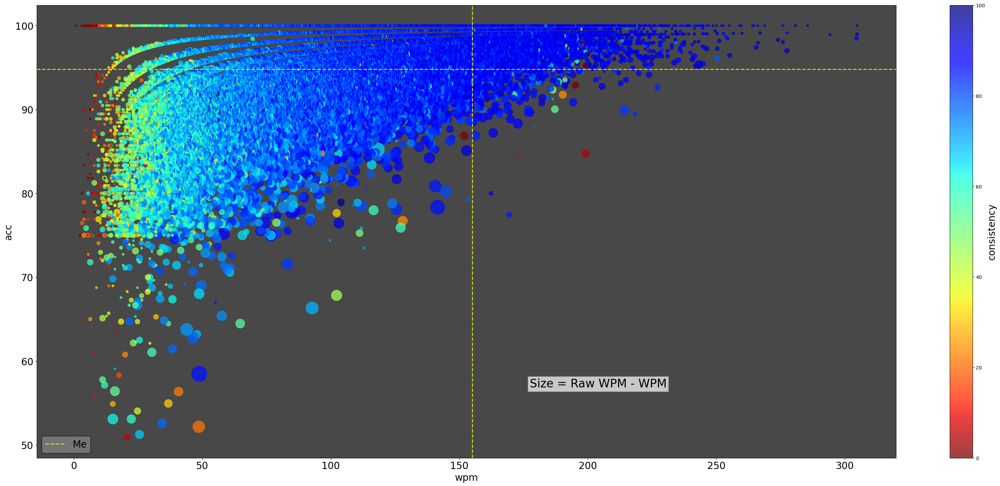

In [127]:
pltscat(df_wpm15,'wpm','acc','diff','consistency',"Size = Raw WPM - WPM",'jet_r')

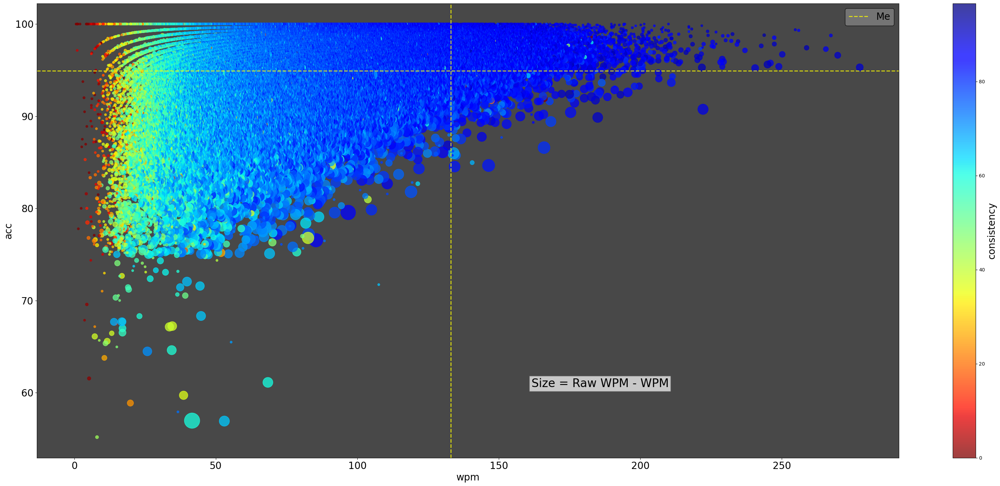

In [128]:
pltscat(df_wpm60,'wpm','acc','diff','consistency',"Size = Raw WPM - WPM",'jet_r')

In [ ]:
pltscat(df_wpm15.query("wpm > 100"),'wpm','acc','diff','consistency',"Size = Raw WPM - WPM",'plasma')

SyntaxError: invalid syntax (1171830727.py, line 1)

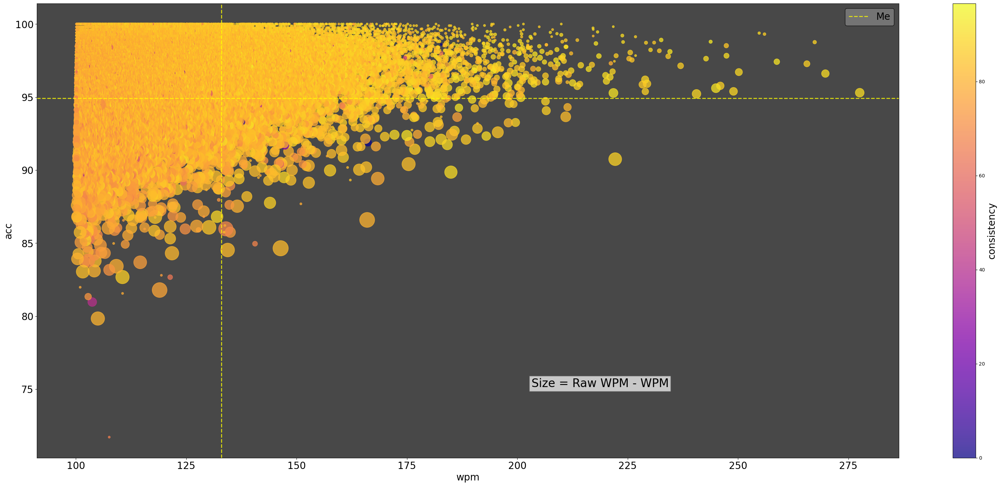

In [ ]:
pltscat(df_wpm60.query("wpm > 100"),'wpm','acc','diff','consistency',"Size = Raw WPM - WPM",'plasma')

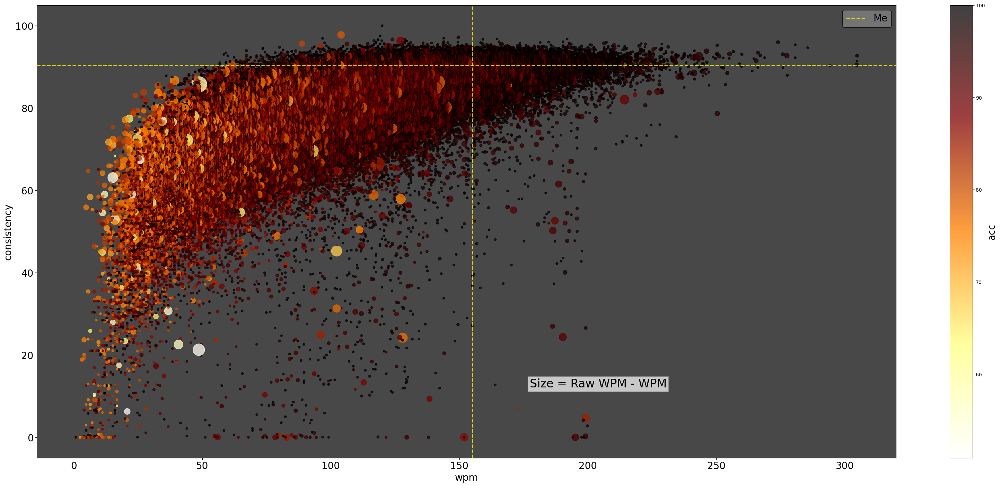

In [ ]:
pltscat(df_wpm15,'wpm','consistency','diff','acc',"Size = Raw WPM - WPM",'afmhot_r')

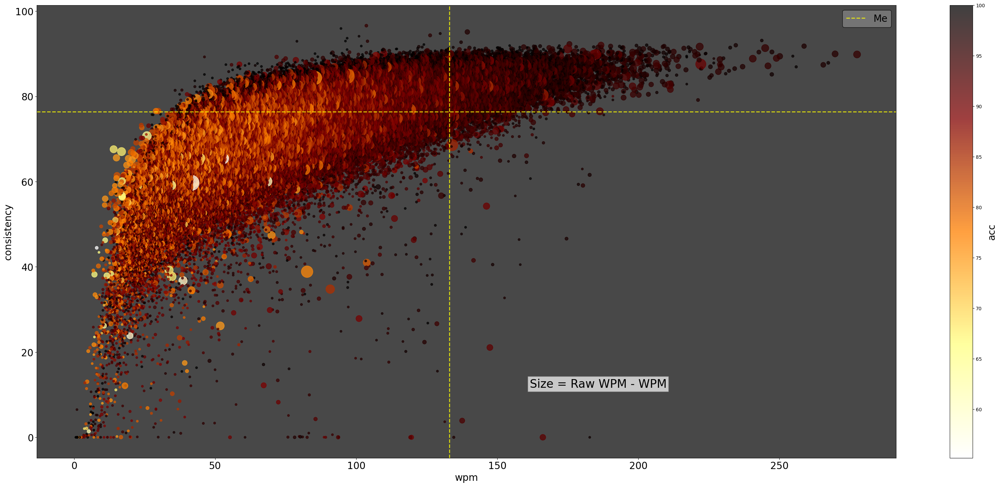

In [ ]:
pltscat(df_wpm60,'wpm','consistency','diff','acc',"Size = Raw WPM - WPM",'afmhot_r')

In [147]:
def binnify(df,bincol,statcol,bin_size):
    dfp = df.copy()
    dfp['bin'] = pd.cut(dfp[bincol], bins=range(int(dfp[bincol].min()), int(dfp[bincol].max())+1+ bin_size, bin_size))

    # Define the statistics you want to calculate
    stats = {
        'mean': 'mean',
        'min': 'min',
        'max': 'max',
        'med': 'median',
        'cnt': 'count',
        'std': 'std'
    }                         
    
    # Initialize the merged DataFrame with the 'bin' column
    merged_df = dfp.groupby('bin', observed=False).size().reset_index().rename(columns={0: 'size'}).drop(columns=['size'])

    for stat_name, func in stats.items():
            stat_df = dfp.groupby('bin', observed=False)[statcol].agg(func).round(1).reset_index().rename(columns={statcol: stat_name})
            #print(f"Shape of {stat_name} DataFrame: {stat_df.shape}")  # Debugging line
            merged_df = merged_df.merge(stat_df, on='bin', how='left')
    merged_df['b'] = [int(interval.left) for interval in dfp['bin'].cat.categories]
    merged_df = merged_df[merged_df['cnt'] > 0]
    
    return merged_df.reset_index(drop=True)

In [142]:
def statbox(df,bincol,statcol,bin_size):
    
    dfp = df.copy()
    dfp['bin'] = pd.cut(dfp[bincol], bins=range(int(dfp[bincol].min()), int(dfp[bincol].max()) + bin_size, bin_size))
    merged_df = binnify(dfp,bincol,statcol,bin_size)
    xwidths = [(w / max(list(merged_df.cnt)))**.8 for w in list(merged_df.cnt)]

    plt.figure(figsize=(10, 6))
    box_plot = sns.boxplot(x='bin', y=statcol, data=dfp, width=xwidths)
    plt.title(f'Box plot of {statcol} by {bincol} with bin size {bin_size}')
    plt.xlabel(bincol)
    plt.ylabel(statcol)
    bin_labels = [f'{int(interval.left)}' for interval in dfp['bin'].cat.categories]

    ex=0
    if bin_size > 2:
        ex=bin_size-2
    
    less_labels = bin_labels[0:len(bin_labels):int((2+ex)/bin_size)]
    plt.xticks(ticks=range(0,len(bin_labels),int((2+ex)/bin_size)), labels=less_labels, rotation=90,fontsize = 6,fontweight='bold')
    
    myacc = int(dfp.loc[dfp['name'] == 'ZeroC00', bincol].values[0])
    minacc = int(dfp[bincol].min())
     
    myx= int(myacc-minacc)//bin_size
    myy = dfp.loc[df['name'] == 'ZeroC00', statcol].values[0]
    plt.axvline(myx, color='red', linestyle='--', alpha = .4,linewidth= 1,label='Me')
    plt.axhline(myy, color='red', linestyle='--', alpha = .4,linewidth= 1)
    
    plt.show()


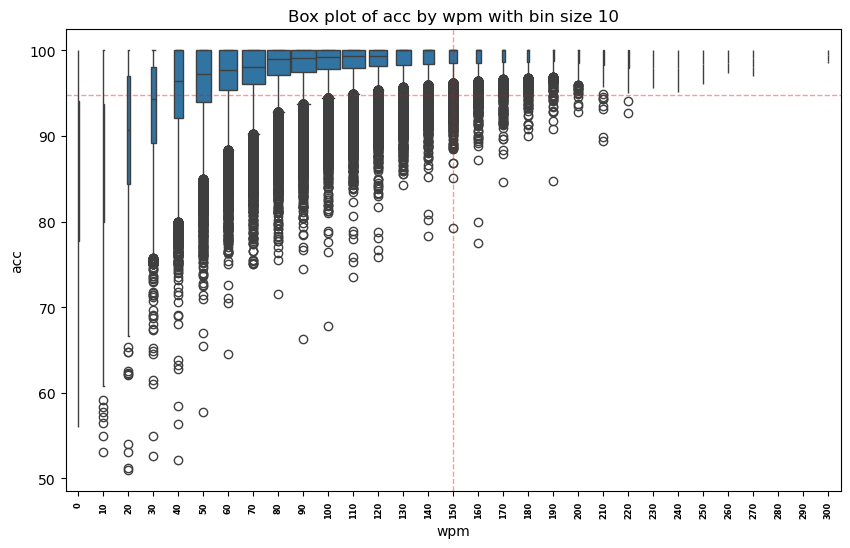

In [143]:
statbox(df_wpm15,'wpm','acc',10)

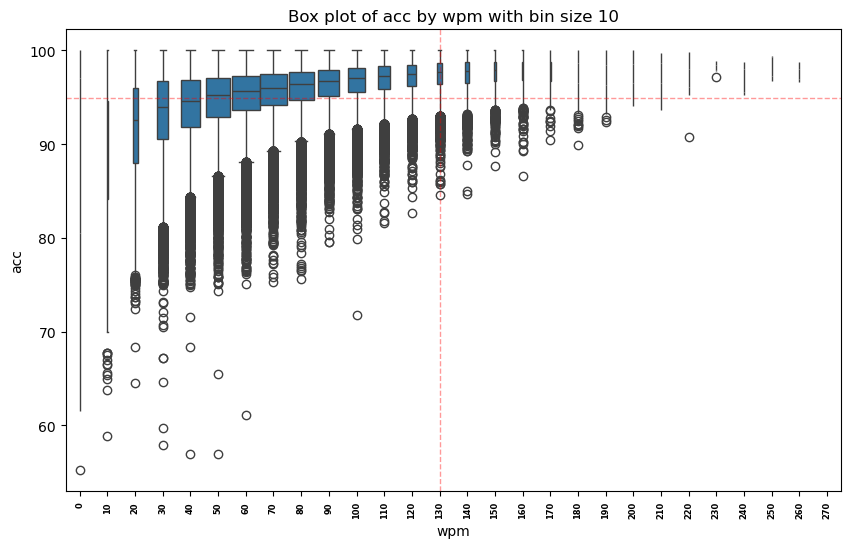

In [144]:
statbox(df_wpm60,'wpm','acc',10)

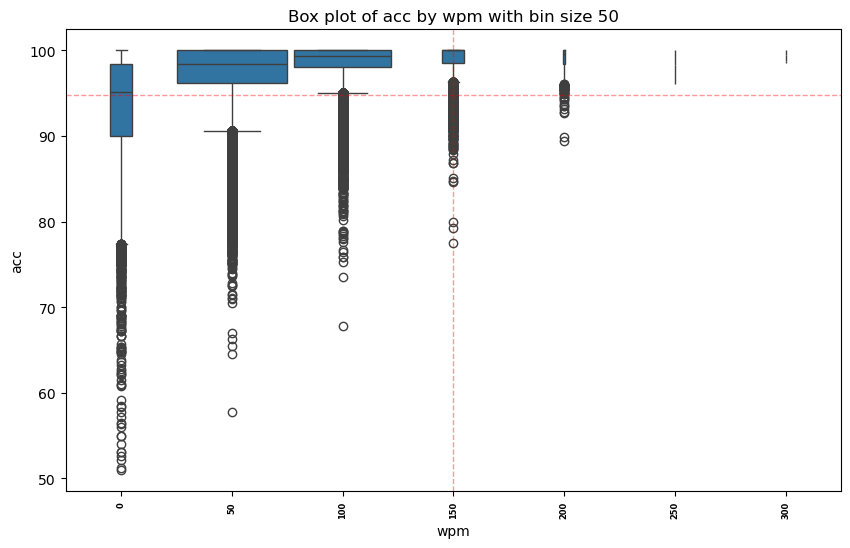

In [ ]:
statbox(df_wpm15,'wpm','acc',50)

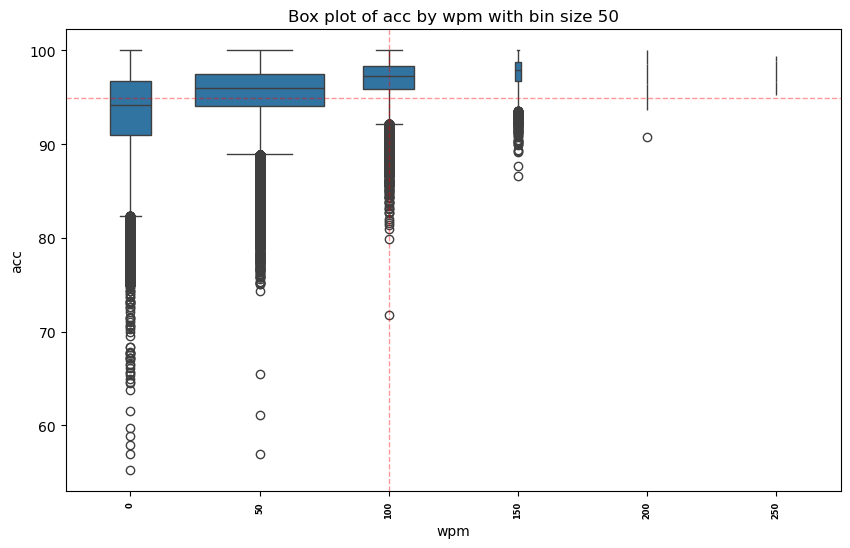

In [ ]:
statbox(df_wpm60,'wpm','acc',50)

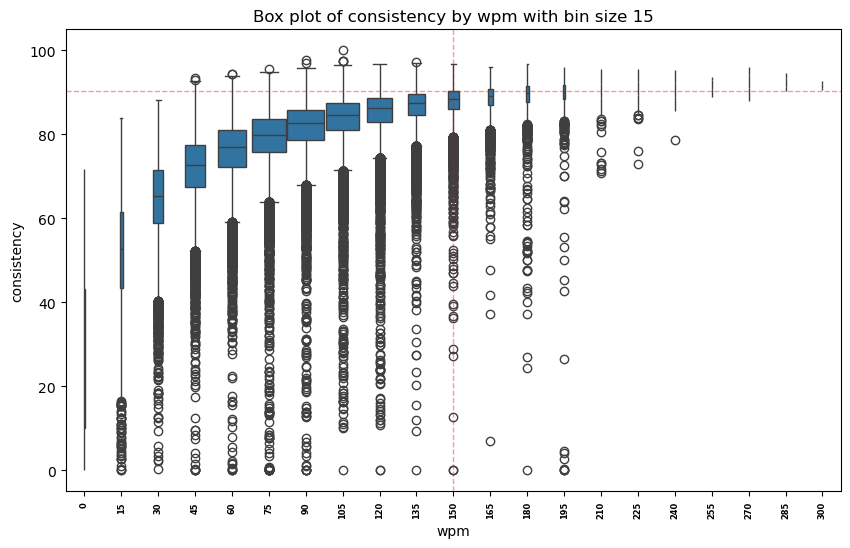

In [ ]:
statbox(df_wpm15,'wpm','consistency',15)

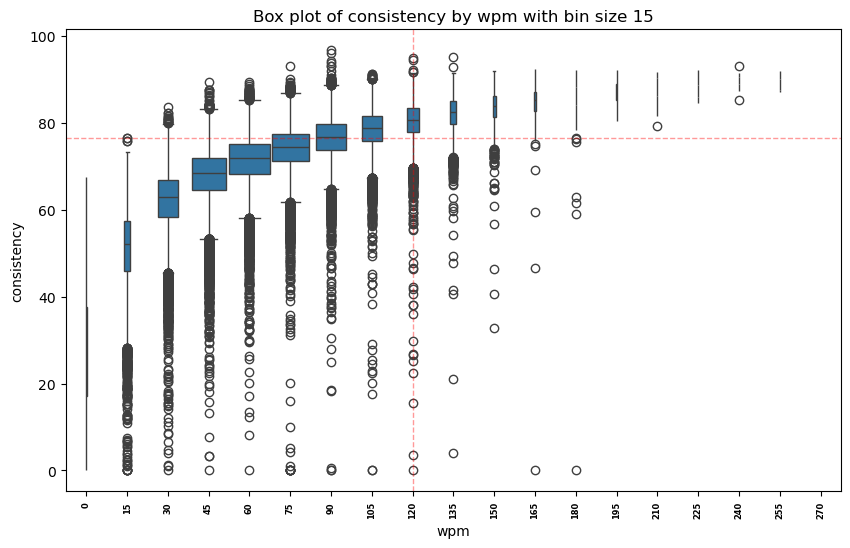

In [145]:
statbox(df_wpm60,'wpm','consistency',15)

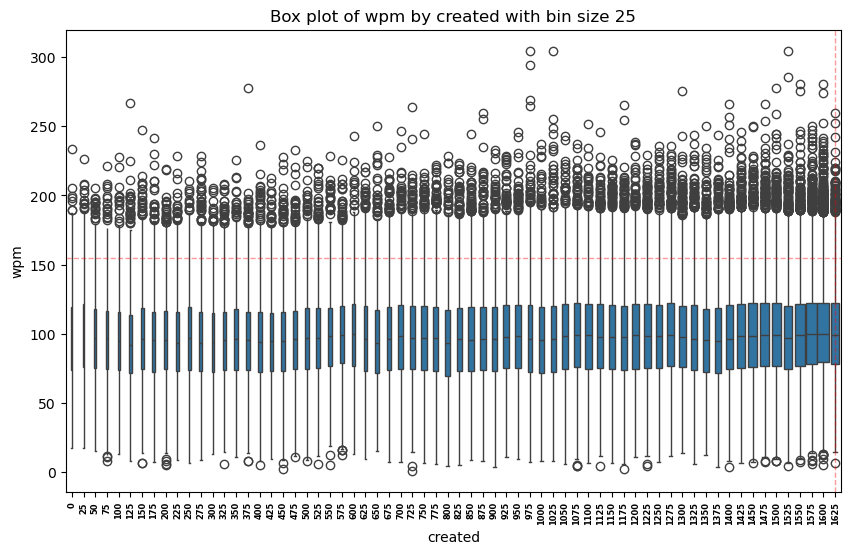

In [ ]:
statbox(df_wpm15,'created','wpm',25)

In [156]:
def plothisto(df,statcol,b,filt=""):
    # Plot histogram
    print(f"int(df[statcol].max()-df[statcol].min()) = {(int(df[statcol].max()-df[statcol].min()))}")
    plt.figure(figsize=(10, 6))
    plt.gca().set_facecolor((0.0, .10, .10, 0.95))
    sns.histplot(df[statcol], bins=int(b*(df[statcol].max()-df[statcol].min())), color = '.8', kde=True)
    plt.title(f'Histogram of {statcol} {filt}')
    plt.xlabel(statcol)
    plt.ylabel('Frequency')

    # Calculate mean and standard deviation of the "accuracy" column
    mean_st= df[statcol].mean()
    std_dev_st = df[statcol].std()
    
    plt.axvline(mean_st, color='yellow', linestyle='-', linewidth=1, label='Mean')

    myval = df.loc[df['name'] == 'ZeroC00', statcol].values[0]
    plt.axvline(myval, color='lime', linestyle='-',linewidth=1, label='Me')

    mxdev = 5
    # Adding standard deviation lines
    for i in range(1, mxdev+1):
        plt.axvline(mean_st + i*std_dev_st, color='white',alpha=.8, linestyle=':',linewidth=.5*((mxdev+1)-i)**.48, label=f'{i}σ')
        plt.axvline(mean_st - i*std_dev_st, color='white',alpha=.8, linestyle=':',linewidth=.5*((mxdev+1)-i)**.48)


    plt.legend(facecolor=(.50, .41,.3, 0.15), edgecolor='black')

    

    # Set x-ticks to align with standard deviation thresholds
    std_devs = [mean_st + i*std_dev_st for i in range(-mxdev, mxdev+1)]
    plt.xticks(std_devs, [f'{mean_st + i*std_dev_st:.2f}' for i in range(-mxdev, mxdev+1)])
    plt.xlim(df[statcol].min()-2,df[statcol].max()+1)

    
    plt.show()

In [151]:
df_wpm15['created'] = pd.to_datetime(df_wpm15['datetime'])-pd.to_datetime(df_wpm15['datetime']).min()
df_wpm15['created'] = df_wpm15['created'].dt.days

df_wpm60['created'] = pd.to_datetime(df_wpm60['datetime'])-pd.to_datetime(df_wpm60['datetime']).min()
df_wpm60['created'] = df_wpm60['created'].dt.days


int(df[statcol].max()-df[statcol].min()) = 1638


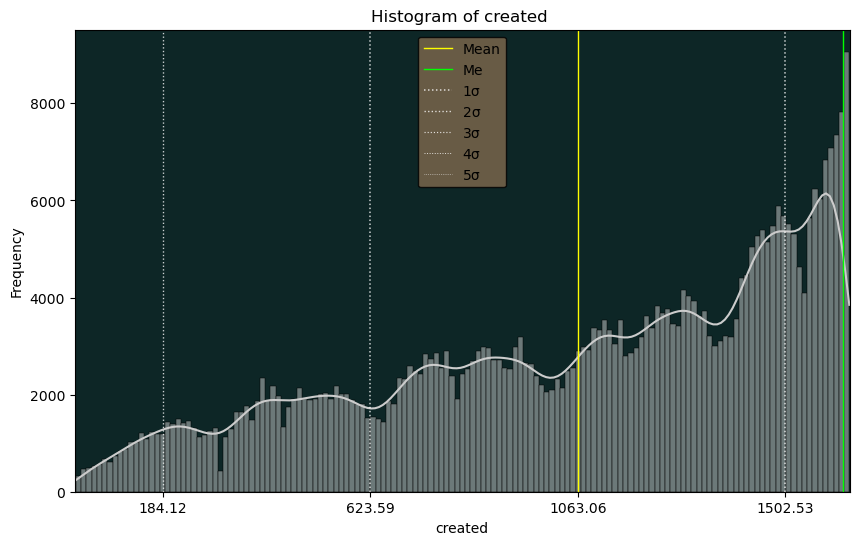

In [152]:
plothisto(df_wpm15,'created',.09)

int(df[statcol].max()-df[statcol].min()) = 1726


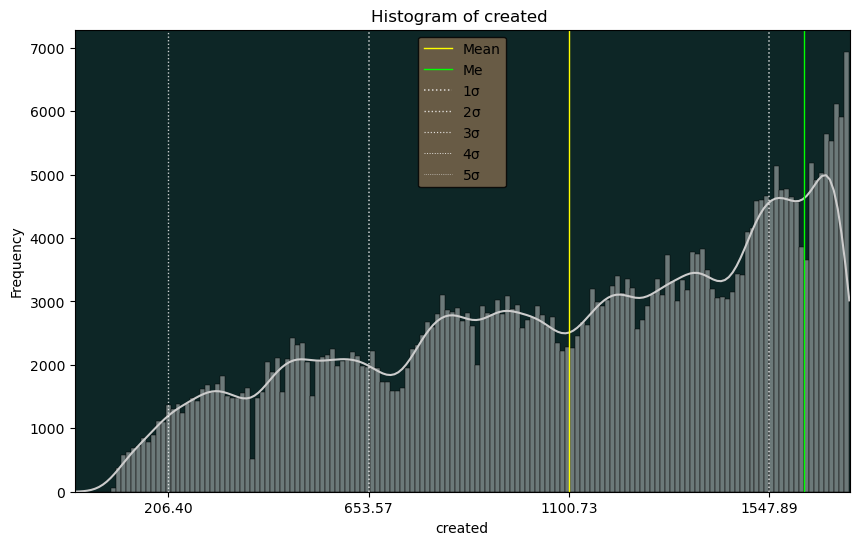

In [ ]:
plothisto(df_wpm60,'created',.09)

int(df[statcol].max()-df[statcol].min()) = 303


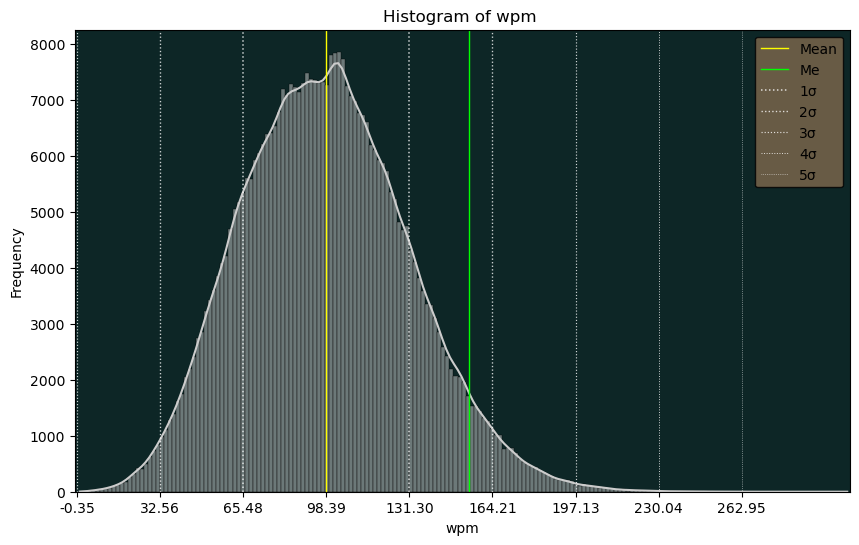

In [153]:
plothisto(df_wpm15,'wpm',.63)

int(df[statcol].max()-df[statcol].min()) = 276


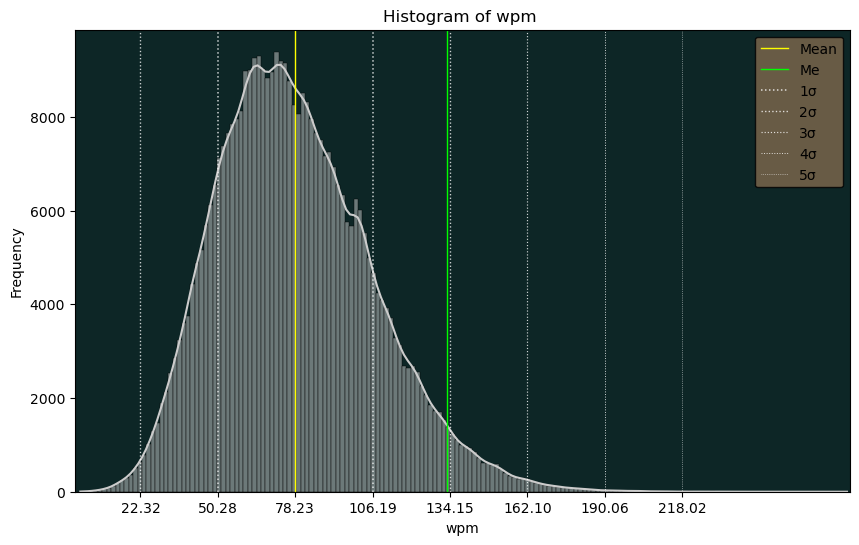

In [158]:
plothisto(df_wpm60,'wpm',.63)

int(df[statcol].max()-df[statcol].min()) = 49


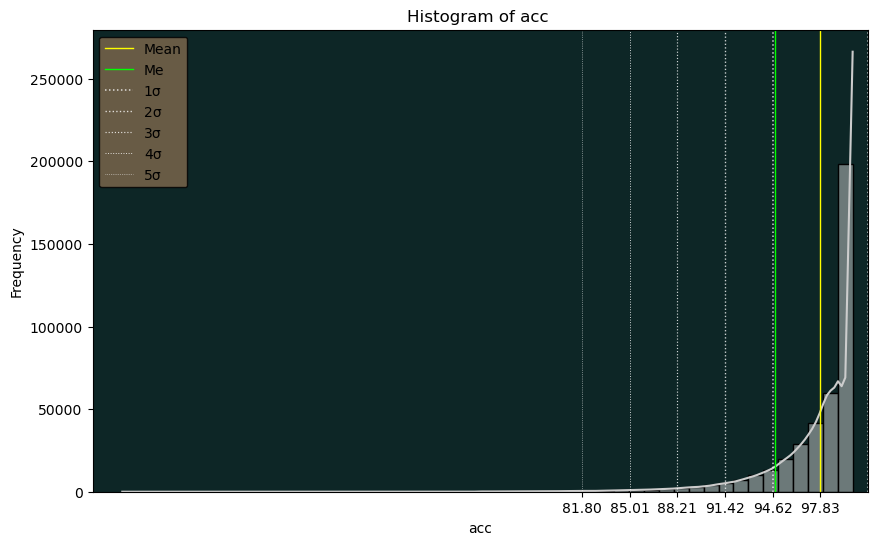

In [ ]:
plothisto(df_wpm15,'acc',1)

In [ ]:
len(df_wpm15)+len(df_wpm60)

795596

int(df[statcol].max()-df[statcol].min()) = 44


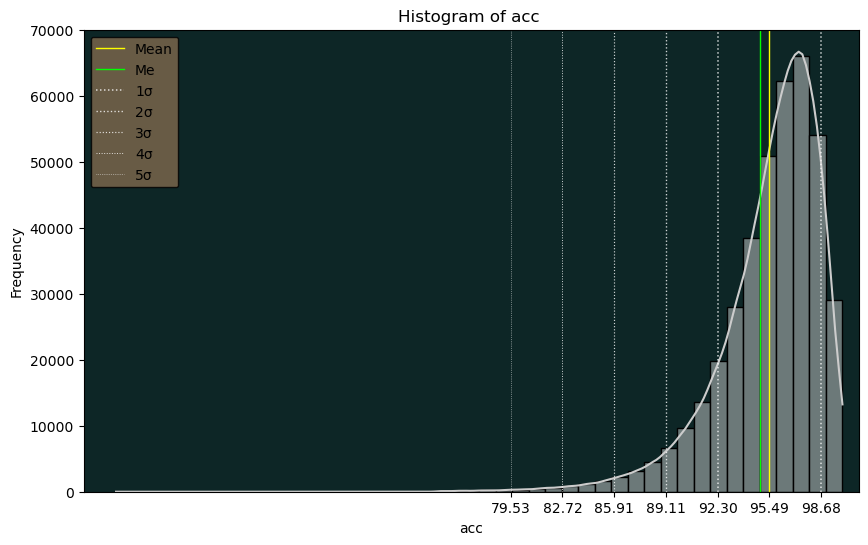

In [ ]:
plothisto(df_wpm60,'acc',1)

int(df[statcol].max()-df[statcol].min()) = 100


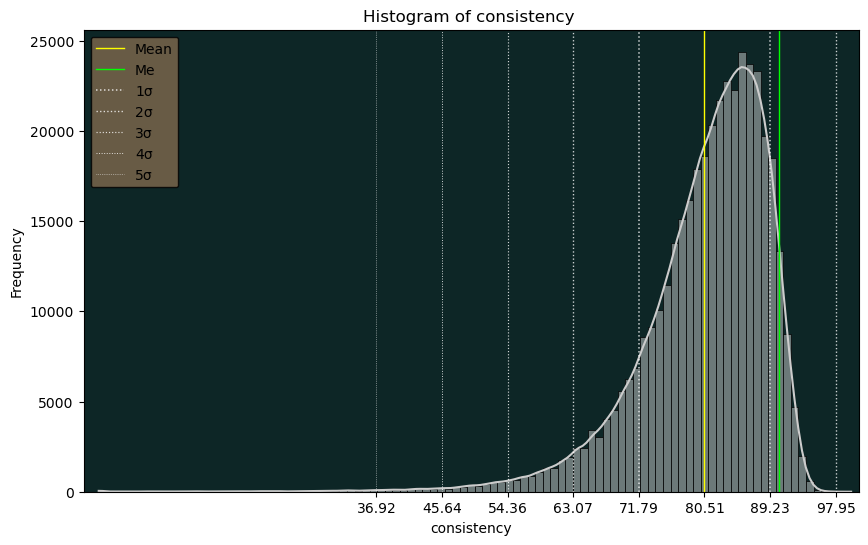

In [ ]:
plothisto(df_wpm15,'consistency',1)

int(df[statcol].max()-df[statcol].min()) = 96


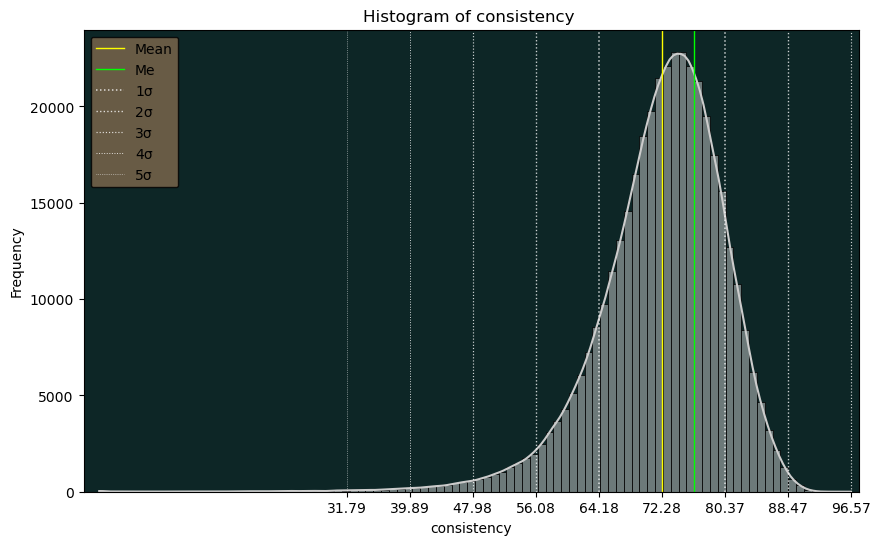

In [ ]:
plothisto(df_wpm60,'consistency',1)

In [ ]:
s15 = df_wpm15.copy()[['wpm']].sort_values('wpm')
s60 = df_wpm60.copy()[['wpm']].sort_values('wpm')

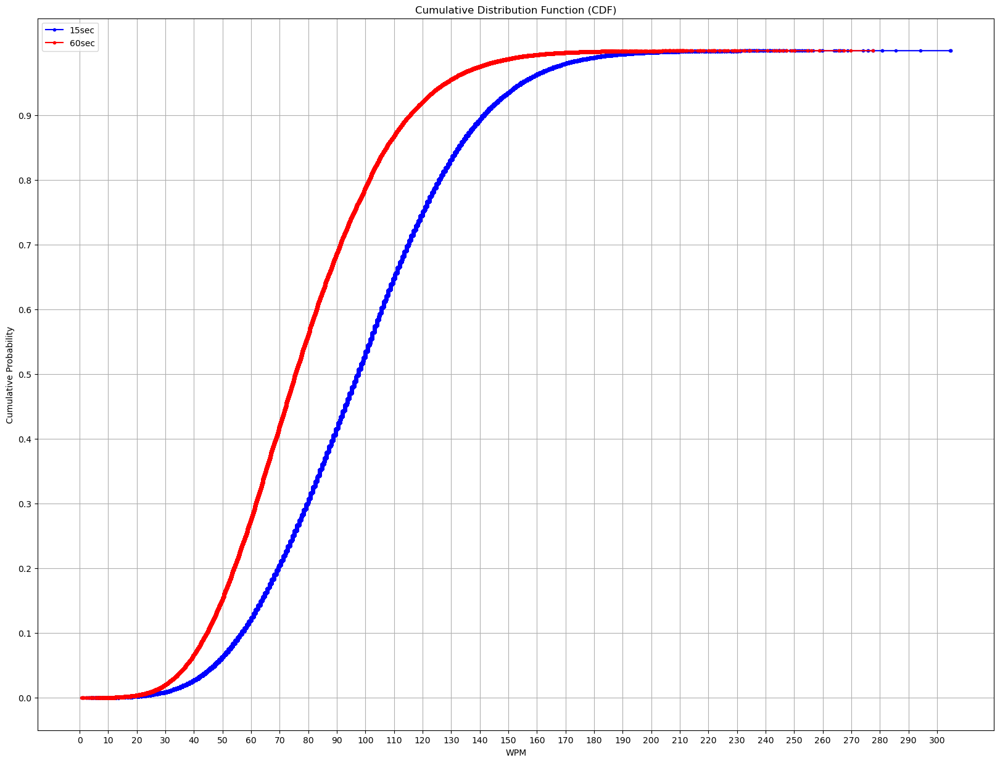

In [ ]:
# Calculate the cumulative probabilities
cdf15 = np.arange(1, len(s15) + 1) / len(s15)
cdf60 = np.arange(1, len(s60) + 1) / len(s60)

# Plot the CDF
plt.figure(figsize=(20, 15))
plt.plot(s15.values, cdf15, label = "15sec", marker='.', color='blue',linestyle='-')
plt.plot(s60.values, cdf60, label = "60sec", marker='.', color='red', linestyle='-')
plt.xticks(ticks=range(0, 310,10), fontsize=10)
plt.yticks(ticks=[x*.1 for x in range(0,10)], fontsize=10)
plt.title("Cumulative Distribution Function (CDF)")
plt.xlabel("WPM")
plt.ylabel("Cumulative Probability")
plt.legend()
plt.grid()
plt.show()

In [130]:
df_comp=df_wpm15.copy()[['wpm']]
df_comp['mode'] = 15
df_comp2=df_wpm60.copy()[['wpm']]
df_comp2['mode'] = 60
df_comp=pd.concat([df_comp,df_comp2],ignore_index=True)
df_comp.head(5)

,wpm,mode
0,304.76,15
1,304.74,15
2,304.60,15
3,294.20,15
4,285.55,15


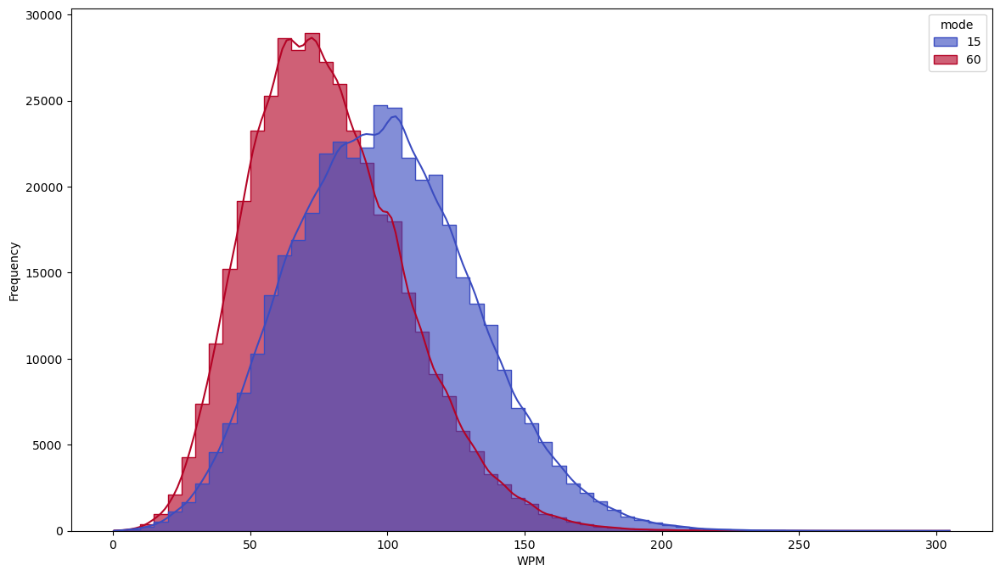

In [ ]:
fig, ax = plt.subplots(figsize=(14, 8))
HIST_BINS = [x for x in range(0,310,5)]
p = sns.histplot(x="wpm",data=df_comp,palette='coolwarm',hue="mode",bins=HIST_BINS,stat="count",alpha=.63,kde=True,\
             common_norm=True,discrete=False,common_bins=True,fill=True,element='step',multiple='layer')
p.set_xlabel("WPM",fontsize=10)
p.set_ylabel("Frequency",fontsize=10)
plt.show()

In [ ]:
fig, ax = plt.subplots(figsize=(14, 8))
HIST_BINS = [x for x in range(0,310,5)]
p = sns.histplot(x="wpm",data=df_comp,palette='coolwarm',hue="mode",bins=HIST_BINS,stat="count",alpha=.63,kde=True,\
             common_norm=True,discrete=False,common_bins=True,fill=True,element='step',multiple='layer')
p.set_xlabel("WPM",fontsize=10)
p.set_ylabel("Frequency",fontsize=10)
plt.show()

In [131]:
df_compare = pd.read_csv('wpmtab.csv').describe().round(2)

In [132]:
df_compare.wpm15-df_compare.wpm60

count     0.00
mean     20.24
std       4.65
min       4.17
25%      16.69
50%      21.96
75%      24.10
max      27.19
dtype: float64

In [ ]:
df_compare.wpm15/df_compare.wpm60

count    1.000000
mean     1.255879
std      1.151515
min      1.194951
25%      1.286327
50%      1.290515
75%      1.250859
max      1.097957
dtype: float64

In [133]:
df_conv=pd.read_csv('wpmtab.csv')

In [134]:
def convert(w,dir="up"):
    if dir == 'up':
        w2 = (df_conv.query("wpm60 <= @w").mult.max())*w
        print(f"A 60sec rate of {w} WPM predicts a 15sec rate of {w2:.2f} WPM")
    else:
        w2 = (1/(df_conv.query("wpm60 <= @w").mult.max()))*w
        print(f"A 15sec rate of {w} WPM predicts a 60sec rate of {w2:.2f} WPM")
    

In [138]:
convert(242.76,"up")

A 60sec rate of 242.76 WPM predicts a 15sec rate of 315.18 WPM


In [136]:
convert(141.36,"down")

A 15sec rate of 141.36 WPM predicts a 60sec rate of 108.88 WPM
